In [1]:
import cv2
import torch
from torch.utils.data import DataLoader, TensorDataset, Dataset

import matplotlib.pyplot as plt
import numpy as np
import torchvision
import torchvision.transforms as transforms

import torch
import torch.nn as nn
import torch.nn.functional as F

from tqdm.notebook import tqdm
import time

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [3]:
# from google.colab import drive
# drive.mount('/content/drive')

In [4]:
# l_images = np.load(r"/content/drive/MyDrive/pclub_b&w/l/gray_scale.npy")
l_images = np.load(r"C:\Users\Vikash kumar singh\Desktop\dataset\pclub_b&w\l\gray_scale.npy")[20000:25000]
# ab1_images = np.load(r"C:\Users\Vikash kumar singh\Desktop\dataset\pclub_b&w\ab\ab\ab1.npy")[:5000]
# ab2_images = np.load(r"C:\Users\Vikash kumar singh\Desktop\dataset\pclub_b&w\ab\ab\ab2.npy")[5000:10000]
ab3_images = np.load(r"C:\Users\Vikash kumar singh\Desktop\dataset\pclub_b&w\ab\ab\ab3.npy")

In [5]:
# ab_images = np.concatenate([ab1_images, ab2_images], axis=0)
ab_images = ab3_images

In [6]:
print(f"L images shape: {l_images.shape}, AB images shape: {ab_images.shape}")

L images shape: (5000, 224, 224), AB images shape: (5000, 224, 224, 2)


In [7]:
num_images = min(l_images.shape[0], ab_images.shape[0])

In [8]:
rgb_images = []

for i in range(num_images):
    l_channel = l_images[i]
    ab_channels = ab_images[i]

    img = np.zeros((224,224,3))
    img[:,:,0] = l_channel
    img[:,:,1:] = ab_channels

    img = img.astype('uint8')

    rgb_image = cv2.cvtColor(img, cv2.COLOR_LAB2RGB)

    rgb_images.append(rgb_image)

In [9]:
rgb_images_np = np.array(rgb_images)

In [10]:
print(f"rgb images shape: {rgb_images_np.shape}")

rgb images shape: (5000, 224, 224, 3)


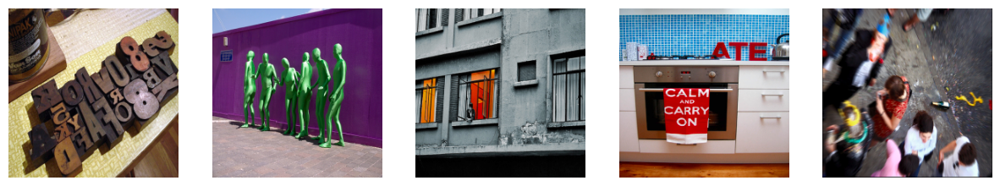

In [11]:
fig, axes = plt.subplots(1, 5, figsize=(15, 3))
for i in range(5):
    axes[i].imshow(rgb_images_np[i])
    axes[i].axis('off')

In [12]:

l_images = l_images[:, np.newaxis, :, :]

l_images_tensor = torch.from_numpy(l_images).float().to(device)


In [13]:
l_images_tensor.shape

torch.Size([5000, 1, 224, 224])

In [15]:
rgb_images_tensor = torch.from_numpy(rgb_images_np).float().to(device)

rgb_images_tensor = rgb_images_tensor.permute(0, 3, 1, 2)

rgb_images_tensor.shape

torch.Size([5000, 3, 224, 224])

In [16]:
transform = transforms.Compose([
    transforms.Lambda(lambda x: x / 255.0),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  
])

In [17]:
transform_l = transforms.Compose([
    transforms.Lambda(lambda x: x / 255.0),  # Scale from [0, 255] to [0, 1]
    transforms.Normalize(mean=[0.5], std=[0.5])  # Normalize to [-1, 1]
])

In [18]:
rgb_images_tensor = transform(rgb_images_tensor)
l_images_tensor = transform_l(l_images_tensor)
torch.cuda.empty_cache()

print(torch.min(rgb_images_tensor))
print(torch.max(rgb_images_tensor))
print(torch.min(l_images_tensor))
print(torch.max(l_images_tensor))

tensor(-1., device='cuda:0')
tensor(1., device='cuda:0')
tensor(-1., device='cuda:0')
tensor(1., device='cuda:0')


In [19]:
dis_dataset = TensorDataset(rgb_images_tensor)

batch_size = 32

dis_data_loader = DataLoader(dis_dataset, batch_size=batch_size, shuffle=True)

for batch in dis_data_loader:
    batch_images = batch[0]
    print("Batch shape:", batch_images.shape)
    break


Batch shape: torch.Size([32, 3, 224, 224])


In [20]:
gen_dataset = TensorDataset(l_images_tensor)

gen_data_loader = DataLoader(gen_dataset, batch_size=batch_size,shuffle=True)

for batch in gen_data_loader:
    batch_images = batch[0]
    print("Batch shape:", batch_images.shape)
    break

Batch shape: torch.Size([32, 1, 224, 224])


In [21]:
# input = torch.randn(1, 3, 224, 224)
# x1 = nn.Conv2d(3,4,kernel_size=3,stride=2)(input)
# print(x1.shape)
# x2= nn.Conv2d(4,16,kernel_size=3,stride=2)(x1)
# print(x2.shape)
# x3 = nn.Conv2d(16,32,kernel_size=3,stride=2)(x2)
# print(x3.shape)
# x4 = nn.Conv2d(32,64,kernel_size=3,stride=2)(x3)
# print(x4.shape)
# x5 = nn.Conv2d(64,128,kernel_size=3,stride=2)(x4)
# print(x5.shape)
# x6 = nn.Conv2d(128,256,kernel_size=3,stride=2)(x5)
# print(x6.shape)
# y1 = nn.ConvTranspose2d(256,128,kernel_size=4,stride=2)(x6)
# print(y1.shape)
# y1 = torch.cat((y1,x5),dim = 1)
# print(y1.shape)
# y2 = nn.ConvTranspose2d(256,64,kernel_size=3,stride=2)(y1)
# print(y2.shape)
# y2 = torch.cat((y2,x4),dim = 1)
# print(y2.shape)
# y3= nn.ConvTranspose2d(128,32,kernel_size=3,stride=2)(y2)
# print(y3.shape)
# y3 = torch.cat((y3,x3),dim = 1)
# print(y3.shape)
# y4= nn.ConvTranspose2d(64,16,kernel_size=3,stride=2)(y3)
# print(y4.shape)
# y4 = torch.cat((y4,x2),dim = 1)
# print(y4.shape)
# y5= nn.ConvTranspose2d(32,4,kernel_size=3,stride=2)(y4)
# print(y5.shape)
# y5 = torch.cat((y5,x1),dim = 1)
# print(y5.shape)
# y6= nn.ConvTranspose2d(8,1,kernel_size=3,stride=2)(y5)
# print(y6.shape)
# out = torch.sigmoid(y6)
# print(out.shape)

torch.Size([1, 4, 111, 111])
torch.Size([1, 16, 55, 55])
torch.Size([1, 32, 27, 27])
torch.Size([1, 64, 13, 13])
torch.Size([1, 128, 6, 6])
torch.Size([1, 256, 2, 2])
torch.Size([1, 128, 6, 6])
torch.Size([1, 256, 6, 6])
torch.Size([1, 64, 13, 13])
torch.Size([1, 128, 13, 13])
torch.Size([1, 32, 27, 27])
torch.Size([1, 64, 27, 27])
torch.Size([1, 16, 55, 55])
torch.Size([1, 32, 55, 55])
torch.Size([1, 4, 111, 111])
torch.Size([1, 8, 111, 111])
torch.Size([1, 1, 223, 223])
torch.Size([1, 1, 223, 223])


In [22]:
class Generator(nn.Module):
    def down(self,in_ch,out_ch):
        return nn.Sequential(
            nn.Conv2d(in_ch,out_ch,kernel_size=3,stride=2),
            nn.BatchNorm2d(out_ch),
            nn.LeakyReLU(0.2)
        )

    def up(self,in_ch,out_ch,kernel_size=3):
            return nn.Sequential(
                nn.ConvTranspose2d(in_ch,out_ch,kernel_size,stride=2),
                nn.BatchNorm2d(out_ch),
                nn.LeakyReLU(0.2)
            )

    def res(self,in_ch,out_ch):
         return nn.Sequential(
              nn.Conv2d(in_ch,out_ch,kernel_size=3,stride=1,padding=1,bias=False),
         )

    def __init__(self):
        super().__init__()
        # downsampling
        self.down1 = self.down(1,4)
        self.down2 = self.down(4,16)
        self.res1  = self.res(16,16)
        self.down3 = self.down(16,32)
        self.res2  = self.res(32,32)
        self.down4 = self.down(32,64)
        self.res3  = self.res(64,64)
        self.down5 = self.down(64,128)
        self.down6 = self.down(128,256)

        # upsampling
        self.up1 = self.up(256,128,4)
        self.up2 = self.up(256,64)
        self.up3 = self.up(128,32)
        self.up4 = self.up(64,16)
        self.up5 = self.up(32,4)
        self.up6 = self.up(8,3)

        self.Upsample = nn.Upsample(size=(224, 224), mode='bilinear', align_corners=True)
        self.tanh = nn.Tanh()

    def forward(self,x):
        # downsampling
        x1 = self.down1(x)
        x2 = self.down2(x1)
        x2 = self.res1(x2)
        x3 = self.down3(x2)
        x3 = self.res2(x3)
        x4 = self.down4(x3)
        x4 = self.res3(x4)
        x5 = self.down5(x4)
        x6 = self.down6(x5)

        # upsampling
        y1 = self.up1(x6)
        y1 = torch.cat((y1,x5),dim=1)
        y2 = self.up2(y1)
        y2 = torch.cat((y2,x4),dim=1)
        y3 = self.up3(y2)
        y3 = torch.cat((y3,x3),dim=1)
        y4 = self.up4(y3)
        y4 = torch.cat((y4,x2),dim=1)
        y5 = self.up5(y4)
        y5 = torch.cat((y5,x1),dim=1)
        y6 = self.up6(y5)
        return self.tanh(self.Upsample(y6))



In [23]:
generator = Generator().to(device)

In [24]:
import torch.nn as nn

def _weights_init_gen(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        # Initialize Conv2d and ConvTranspose2d weights with a normal distribution (mean=0, std=0.02)
        nn.init.normal_(m.weight, mean=0.0, std=0.02)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

    if isinstance(m, nn.BatchNorm2d):
        # Initialize BatchNorm2d weights with a normal distribution (mean=1, std=0.02)
        nn.init.normal_(m.weight, mean=1.0, std=0.02)
        # Initialize the bias with zeros
        nn.init.constant_(m.bias, 0)

In [25]:
generator.apply(_weights_init_gen)

Generator(
  (down1): Sequential(
    (0): Conv2d(1, 4, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(4, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
  (down2): Sequential(
    (0): Conv2d(4, 16, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
  (res1): Sequential(
    (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (down3): Sequential(
    (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
  )
  (res2): Sequential(
    (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (down4): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2))
    (1): BatchNorm2d(64, eps=1e-05, momentu

In [26]:
for batch in gen_data_loader:
    inputs = batch[0].to(device)
    output = generator(inputs)
    print("Generator Output Shape:", output.shape)
    print("Generator Output Max Value:", torch.max(output).item())
    print("Generator Output Min Value:", torch.min(output).item())
    break

Generator Output Shape: torch.Size([32, 3, 224, 224])
Generator Output Max Value: 0.9999973773956299
Generator Output Min Value: -0.8898873329162598


In [27]:
class Discriminator(nn.Module):
    def down(self,in_ch,out_ch):
        return nn.Sequential(
            nn.Conv2d(in_ch,out_ch,kernel_size=3,stride=2),
            nn.BatchNorm2d(out_ch),
            nn.LeakyReLU(0.2)
        )


    def __init__(self):
        super().__init__()
        # downsampling
        self.down1 = self.down(3,4)
        self.down2 = self.down(4,16)
        self.down3 = self.down(16,32)
        self.down4 = self.down(32,64)
        self.down5 = self.down(64,128)
        self.down6 = self.down(128,256)

        self.pool = nn.MaxPool2d(1)
        self.flat = nn.Flatten()
        self.lin1 = nn.Linear(1024,1)
        self.sig = nn.Sigmoid()

    def forward(self,x):
        # downsampling
        x1 = self.down1(x)
        x2 = self.down2(x1)
        x3 = self.down3(x2)
        x4 = self.down4(x3)
        x5 = self.down5(x4)
        x6 = self.down6(x5)
        y1 = self.pool(x6)
        y2 = self.flat(y1)
        y3 = self.lin1(y2)
        y4 = self.sig(y3)
        return y4

In [28]:
discriminator  = Discriminator().to(device)

In [29]:
for batch in dis_data_loader:
    inputs = batch[0].to(device)
    output = discriminator(inputs)
    print("Discriminator Output Shape:", output.shape)
    print("Discriminator Output Max Value:", torch.max(output).item())
    print("Discriminator Output Min Value:", torch.min(output).item())
    break

Discriminator Output Shape: torch.Size([32, 1])
Discriminator Output Max Value: 0.5779666900634766
Discriminator Output Min Value: 0.29041996598243713


In [30]:
class RGB_L_Dataset(Dataset):
    def __init__(self, l_images, rgb_images):
        self.l_images = l_images
        self.rgb_images = rgb_images

    def __len__(self):
        return len(self.l_images)

    def __getitem__(self, idx):
        l_img = self.l_images[idx]
        rgb_img = self.rgb_images[idx]

        return rgb_img, l_img

In [31]:
dataset = RGB_L_Dataset(l_images_tensor, rgb_images_tensor)
train_dl = DataLoader(dataset, batch_size=32, shuffle=True)

In [32]:
import numpy as np
import matplotlib.pyplot as plt

def show_images(rgb_image1, l_image, rgb_image2):
    # Move images to CPU if they are on GPU
    if rgb_image1.is_cuda:
        rgb_image1 = rgb_image1.cpu()
    if l_image.is_cuda:
        l_image = l_image.cpu()
    if rgb_image2.is_cuda:
        rgb_image2 = rgb_image2.cpu()

    # Convert tensors to numpy arrays
    rgb_np1 = rgb_image1.detach().numpy()  # No scaling here; it's in [-1, 1]
    l_np = l_image.detach().numpy()        # Assuming l_image is in [0, 1]
    rgb_np2 = rgb_image2.detach().numpy()  # No scaling here; it's in [-1, 1]

    # Transpose to (H, W, C) and scale RGB images from [-1, 1] to [0, 255]
    rgb_np1 = np.transpose(rgb_np1, (1, 2, 0)).clip(-1, 1)  # Clip to avoid values outside [-1, 1]
    rgb_np1 = ((rgb_np1 + 1) * 127.5).clip(0, 255).astype(np.uint8)  # Scale to [0, 255]

    l_np = np.transpose(l_np, (1, 2, 0)).clip(0, 1) * 255  # Scale L channel to [0, 255]
    l_np = l_np.astype(np.uint8)

    rgb_np2 = np.transpose(rgb_np2, (1, 2, 0)).clip(-1, 1)  # Clip to avoid values outside [-1, 1]
    rgb_np2 = ((rgb_np2 + 1) * 127.5).clip(0, 255).astype(np.uint8)  # Scale to [0, 255]

    # Create a new figure
    plt.figure(figsize=(12, 4))

    # Show the first RGB image
    plt.subplot(1, 3, 1)
    plt.imshow(rgb_np1)
    plt.axis('off')
    plt.title('RGB Image 1')

    # Show the L image in grayscale
    plt.subplot(1, 3, 2)
    plt.imshow(l_np, cmap='gray')
    plt.axis('off')
    plt.title('L Channel Image')

    # Show the second RGB image
    plt.subplot(1, 3, 3)
    plt.imshow(rgb_np2)
    plt.axis('off')
    plt.title('RGB Image 2')

    # Display the images
    plt.tight_layout()
    plt.show()



In [33]:
def save_checkpoint(epoch, model, optimizer, loss, filename):
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': loss,
    }, filename)
    print(f"Model saved at epoch {epoch+1}")

In [34]:
loss_d = nn.BCELoss()
loss_g_1 = nn.BCELoss()
loss_g_2 = nn.L1Loss()

In [35]:
def train_discriminator(rgb_images,l_images,opt_d):

    smooth = 0.1
    opt_d.zero_grad()

    #pass real images through discriminator
    real_preds=discriminator(rgb_images)
    real_loss=loss_d(real_preds, ((1 - smooth) * torch.ones_like(real_preds).to(device)))

    #generate fake images
    fake_images=generator(l_images)

    #pass fake images through discriminator
    fake_preds=discriminator(fake_images)
    fake_loss=loss_d(fake_preds,((1 - smooth) * torch.zeros_like(real_preds).to(device)))

    #update discriminator weights
    loss=real_loss+fake_loss
    loss.backward()
    opt_d.step()

    return loss.item(),real_loss,fake_loss,fake_images

In [36]:
def train_generator(rgb_images,l_images,opt_g):

    g_lambda = 100
    opt_g.zero_grad()

    #generate fake images
    fake_images=generator(l_images)

    #try to fool discriminator
    preds=discriminator(fake_images)
    fake_loss=loss_g_1(preds,(torch.ones_like(preds).to(device)))

    distance_loss=g_lambda*loss_g_2(fake_images,rgb_images)

    #update generator weights
    loss=fake_loss+distance_loss
    loss.backward()
    opt_g.step()

    return loss.item(),fake_loss,distance_loss

In [63]:
generator = Generator().to(device)
discriminator = Discriminator().to(device)

gen_checkpoint = torch.load(r"gen\gen401ab3.pth")
generator.load_state_dict(gen_checkpoint['model_state_dict'])
generator.train()

dis_checkpoint = torch.load(r"dis\dis401ab3.pth")
discriminator.load_state_dict(dis_checkpoint['model_state_dict'])
discriminator.train()

initial_epoch = gen_checkpoint['epoch'] + 1



C:\Users\Vikash kumar singh\AppData\Local\Temp\ipykernel_16920\1918153455.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen_checkpoint = torch.load(r"gen\gen401ab3.pth

In [64]:
def fit(epochs, lr=0.0002, start_idx=1):
    torch.cuda.empty_cache()

    # Losses & scores
    losses_g = []
    losses_d = []
    fake_losses_g = []
    distance_losses_g = []
    fake_losses_d = []
    real_losses_d = []

    # Create optimizers
    # opt_d = torch.optim.Adam(discriminator.parameters(), betas=(0.5, 0.999), lr=lr) # my dis became too strong after 80 epochs
    # opt_d = torch.optim.Adam(discriminator.parameters(), betas=(0.5, 0.999), lr=lr * 0.5) # it too much wekened the dis so after 100 epoch
    # opt_d = torch.optim.Adam(discriminator.parameters(), betas=(0.5, 0.999), lr=lr * 0.75)  # strong dis after 116
    # opt_d = torch.optim.Adam(discriminator.parameters(), betas=(0.5, 0.999), lr=lr * 0.6)
    # opt_d = torch.optim.Adam(discriminator.parameters(), betas=(0.5, 0.999), lr=lr * 0.75)  # too strong dis
    opt_d = torch.optim.Adam(discriminator.parameters(), betas=(0.5, 0.999), lr=lr * 0.1)

    opt_g = torch.optim.Adam(generator.parameters(), betas=(0.5, 0.999), lr=lr)

    scheduler_g = torch.optim.lr_scheduler.ReduceLROnPlateau(opt_g, mode='min', factor=0.25, patience=7, verbose=True)
    scheduler_d = torch.optim.lr_scheduler.ReduceLROnPlateau(opt_d, mode='min', factor=0.25, patience=7, verbose=True)   # strong dis after 116
    # scheduler_d = torch.optim.lr_scheduler.ReduceLROnPlateau(opt_d, mode='min', factor=0.5, patience=5, verbose=True)

    # Start the timer
    start_time = time.time()

    for epoch in range(initial_epoch,epochs):
        total_loss_g = 0.0
        total_loss_d = 0.0
        total_real_loss_d = 0.0
        total_fake_loss_d = 0.0
        total_fake_loss_g = 0.0
        total_distance_loss_g = 0.0
        num_batches = len(train_dl)

        for rgb_images, l_images in tqdm(train_dl):
            # Train discriminator
            loss_d, real_loss_d, fake_loss_d, fake_images = train_discriminator(rgb_images, l_images, opt_d)
            # Train generator
            loss_g, fake_loss_g, distance_loss_g = train_generator(rgb_images, l_images, opt_g)

            total_loss_d += loss_d
            total_loss_g += loss_g
            total_real_loss_d += real_loss_d
            total_fake_loss_d += fake_loss_d
            total_fake_loss_g += fake_loss_g
            total_distance_loss_g += distance_loss_g

        # Compute mean losses
        mean_loss_g = total_loss_g / num_batches
        mean_loss_d = total_loss_d / num_batches
        mean_real_loss_d = total_real_loss_d / num_batches
        mean_fake_loss_d = total_fake_loss_d / num_batches
        mean_fake_loss_g = total_fake_loss_g / num_batches
        mean_distance_loss_g = total_distance_loss_g / num_batches

        scheduler_g.step(mean_loss_g)
        scheduler_d.step(mean_loss_d)

        # Record losses & scores
        losses_g.append(mean_loss_g)
        losses_d.append(mean_loss_d)
        real_losses_d.append(mean_real_loss_d)
        fake_losses_d.append(mean_fake_loss_d)
        fake_losses_g.append(mean_fake_loss_g)
        distance_losses_g.append(mean_distance_loss_g)

        # End the timer
        end_time = time.time()
        total_duration = end_time - start_time

        # Log mean losses & scores
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_loss_d: {:.4f}, fake_loss_d: {:.4f}, fake_loss_g: {:.4f}, distance_loss_g: {:.4f}, duration: {:.4f}".format(
            epoch+1, epochs, mean_loss_g, mean_loss_d, mean_real_loss_d, mean_fake_loss_d, mean_fake_loss_g, mean_distance_loss_g, total_duration))

        show_images(rgb_images[0], l_images[0], fake_images[0])

        # Save models
        if epoch % 5 == 0:
            save_checkpoint(epoch, generator, opt_g, mean_loss_g, filename=f"gen/gen{epoch+1}ab3.pth")
            save_checkpoint(epoch, discriminator, opt_d, mean_loss_d, filename=f"dis/dis{epoch+1}ab3.pth")

    return losses_g, losses_d, real_losses_d, fake_losses_d, fake_losses_g, distance_losses_g


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [402/431], loss_g: 12.9719, loss_d: 1.2177, real_loss_d: 0.7654, fake_loss_d: 0.4523, fake_loss_g: 1.4756, distance_loss_g: 11.4963, duration: 14.2722


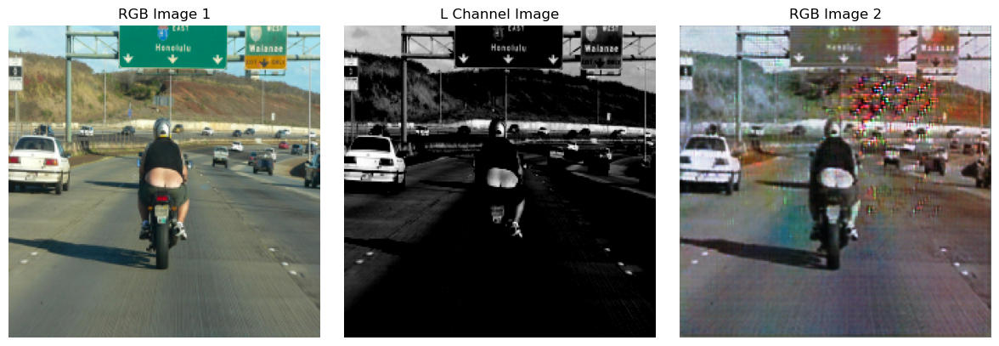

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [403/431], loss_g: 12.9129, loss_d: 1.0545, real_loss_d: 0.6430, fake_loss_d: 0.4115, fake_loss_g: 1.4707, distance_loss_g: 11.4422, duration: 27.5445


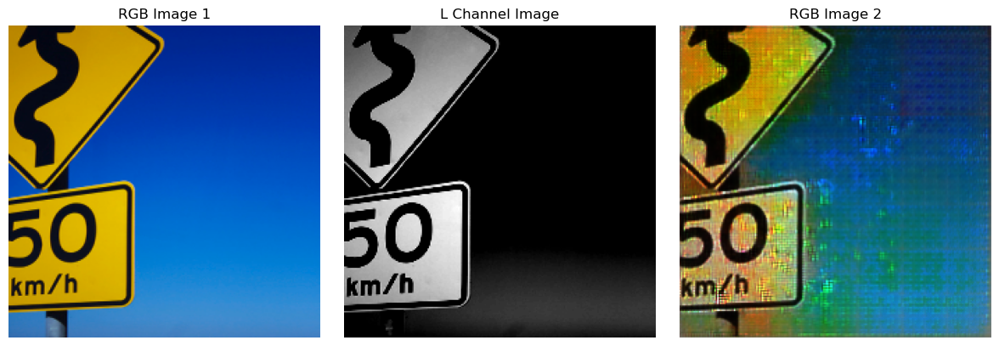

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [404/431], loss_g: 12.9953, loss_d: 0.9126, real_loss_d: 0.5677, fake_loss_d: 0.3449, fake_loss_g: 1.7283, distance_loss_g: 11.2669, duration: 39.8007


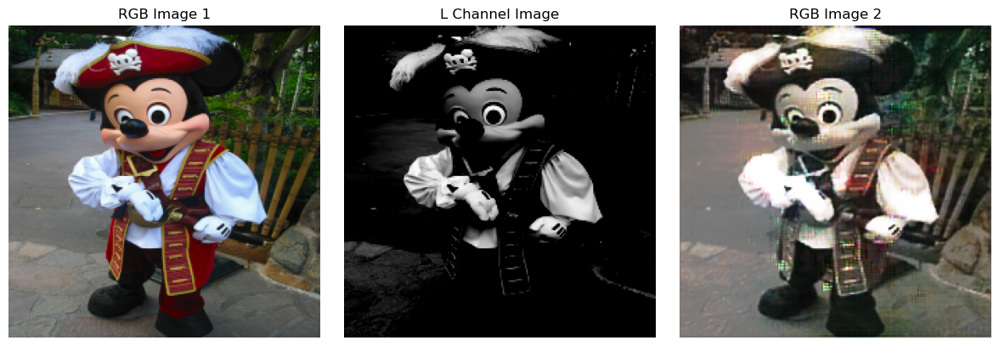

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [405/431], loss_g: 12.7656, loss_d: 1.0074, real_loss_d: 0.6244, fake_loss_d: 0.3829, fake_loss_g: 1.5837, distance_loss_g: 11.1819, duration: 52.6370


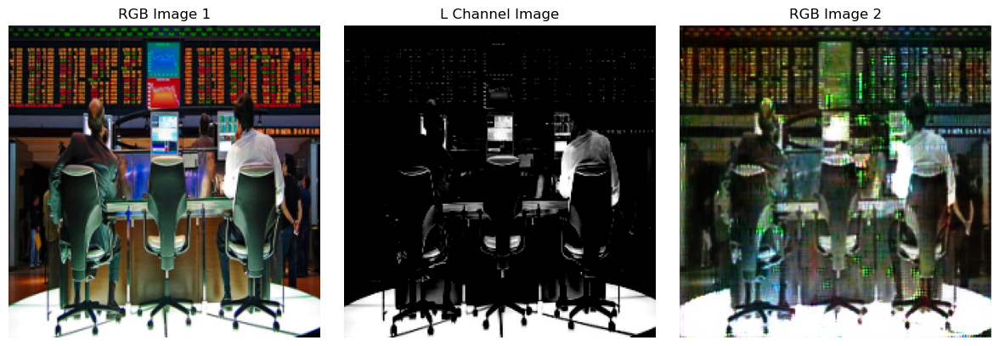

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [406/431], loss_g: 12.7691, loss_d: 0.9649, real_loss_d: 0.6024, fake_loss_d: 0.3624, fake_loss_g: 1.6818, distance_loss_g: 11.0872, duration: 66.2055


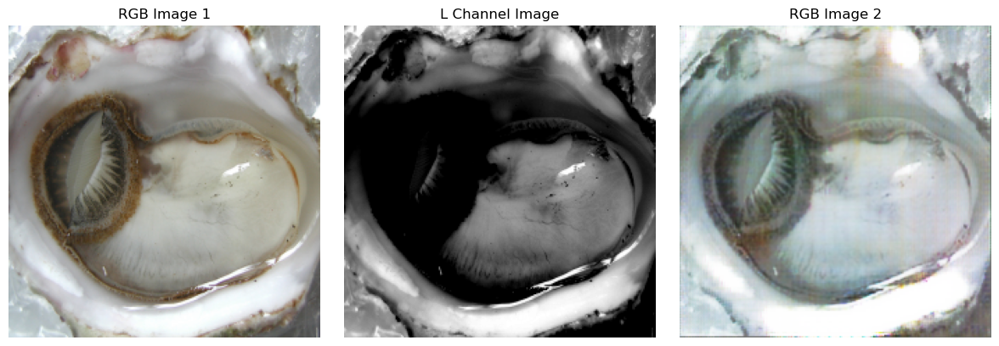

Model saved at epoch 406
Model saved at epoch 406


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [407/431], loss_g: 12.5886, loss_d: 1.0072, real_loss_d: 0.6057, fake_loss_d: 0.4015, fake_loss_g: 1.5196, distance_loss_g: 11.0690, duration: 78.7594


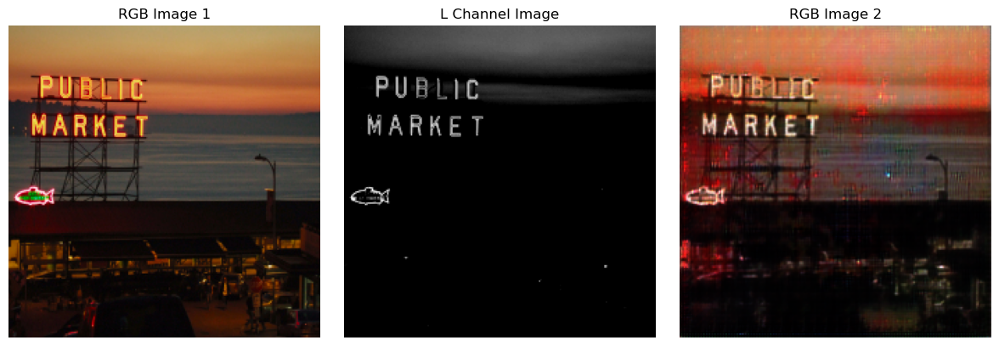

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [408/431], loss_g: 12.8251, loss_d: 1.0495, real_loss_d: 0.6415, fake_loss_d: 0.4080, fake_loss_g: 1.5722, distance_loss_g: 11.2530, duration: 92.1490


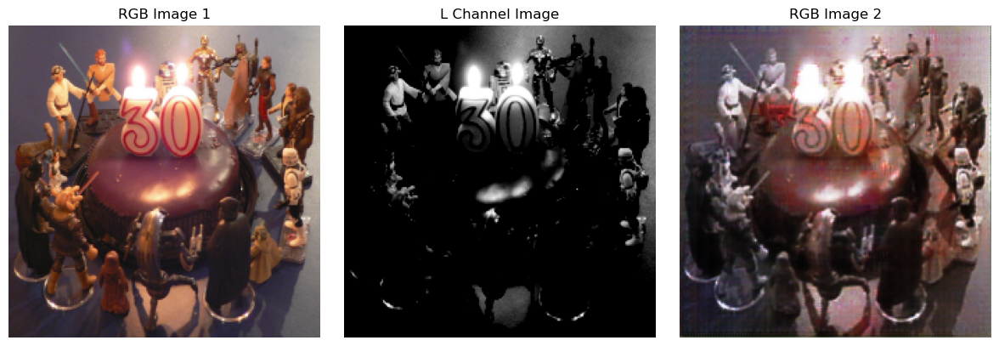

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [409/431], loss_g: 12.4803, loss_d: 1.0783, real_loss_d: 0.6467, fake_loss_d: 0.4316, fake_loss_g: 1.4249, distance_loss_g: 11.0554, duration: 105.9831


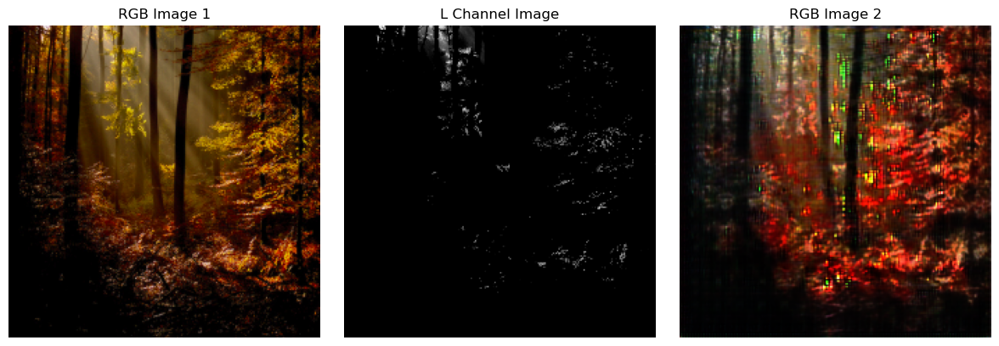

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [410/431], loss_g: 12.7429, loss_d: 0.9951, real_loss_d: 0.6233, fake_loss_d: 0.3718, fake_loss_g: 1.5882, distance_loss_g: 11.1547, duration: 119.5877


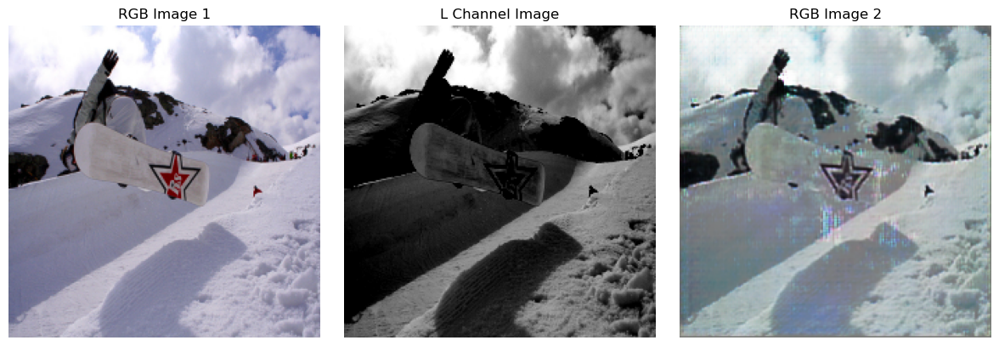

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [411/431], loss_g: 12.7327, loss_d: 0.9983, real_loss_d: 0.6199, fake_loss_d: 0.3783, fake_loss_g: 1.6404, distance_loss_g: 11.0923, duration: 133.9677


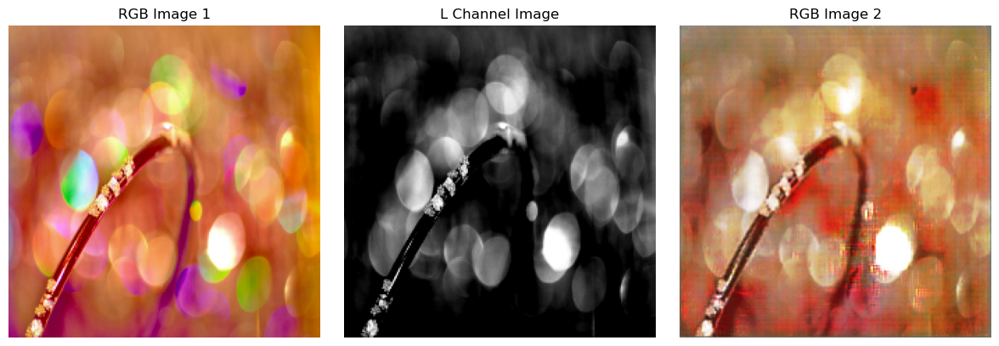

Model saved at epoch 411
Model saved at epoch 411


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [412/431], loss_g: 12.5936, loss_d: 1.0021, real_loss_d: 0.6073, fake_loss_d: 0.3948, fake_loss_g: 1.5450, distance_loss_g: 11.0486, duration: 147.0361


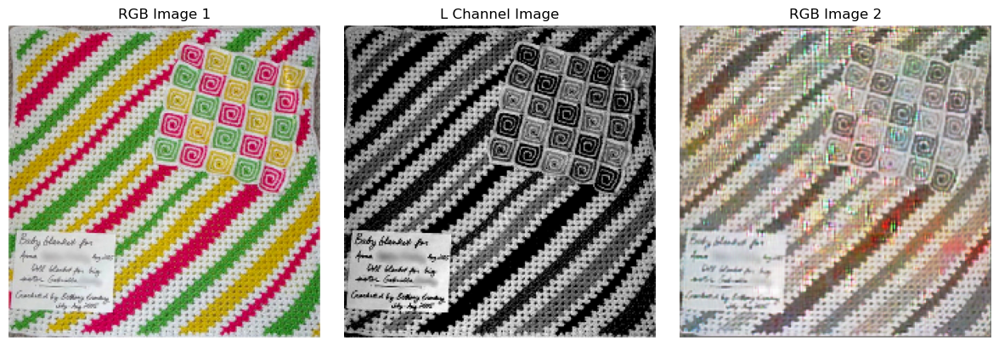

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [413/431], loss_g: 12.2206, loss_d: 1.2336, real_loss_d: 0.6854, fake_loss_d: 0.5481, fake_loss_g: 1.2337, distance_loss_g: 10.9869, duration: 159.5783


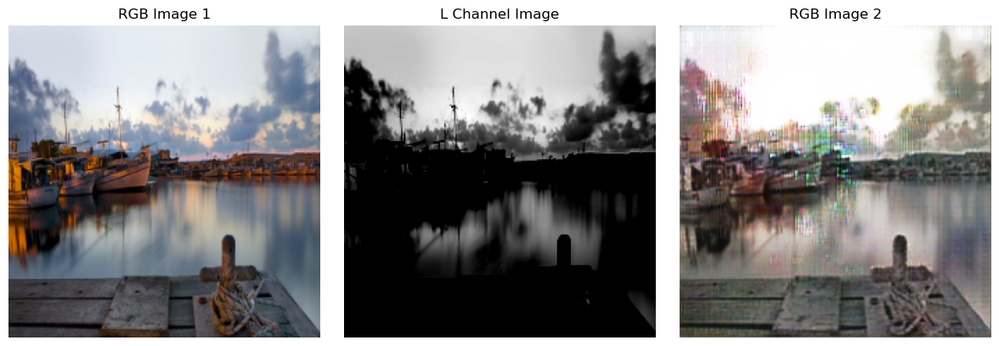

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [414/431], loss_g: 12.2112, loss_d: 1.2946, real_loss_d: 0.7161, fake_loss_d: 0.5785, fake_loss_g: 1.1425, distance_loss_g: 11.0687, duration: 171.9710


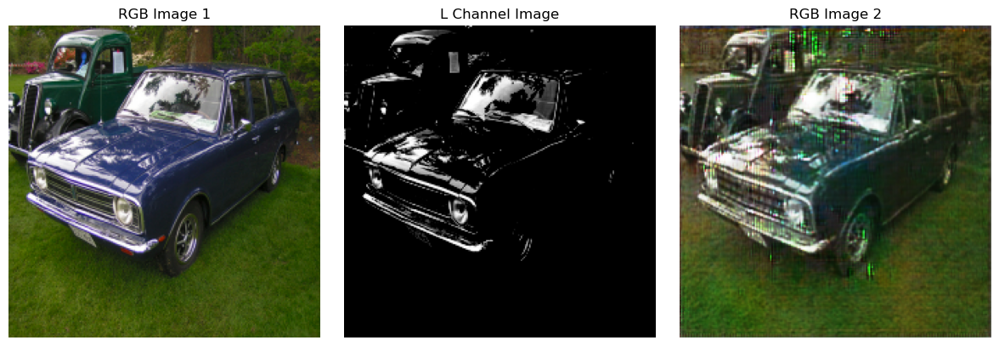

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [415/431], loss_g: 12.1828, loss_d: 1.3689, real_loss_d: 0.7786, fake_loss_d: 0.5902, fake_loss_g: 1.1518, distance_loss_g: 11.0310, duration: 183.6010


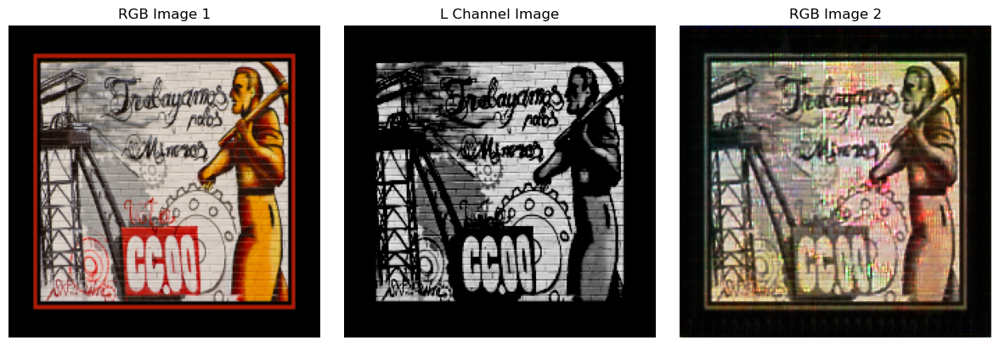

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [416/431], loss_g: 12.1234, loss_d: 1.4968, real_loss_d: 0.8298, fake_loss_d: 0.6670, fake_loss_g: 0.9645, distance_loss_g: 11.1589, duration: 194.6519


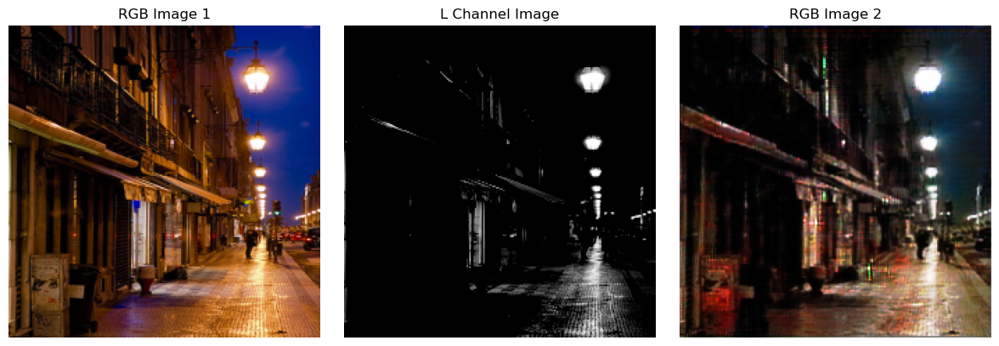

Model saved at epoch 416
Model saved at epoch 416


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [417/431], loss_g: 12.2430, loss_d: 1.3624, real_loss_d: 0.8009, fake_loss_d: 0.5615, fake_loss_g: 1.1520, distance_loss_g: 11.0909, duration: 206.4011


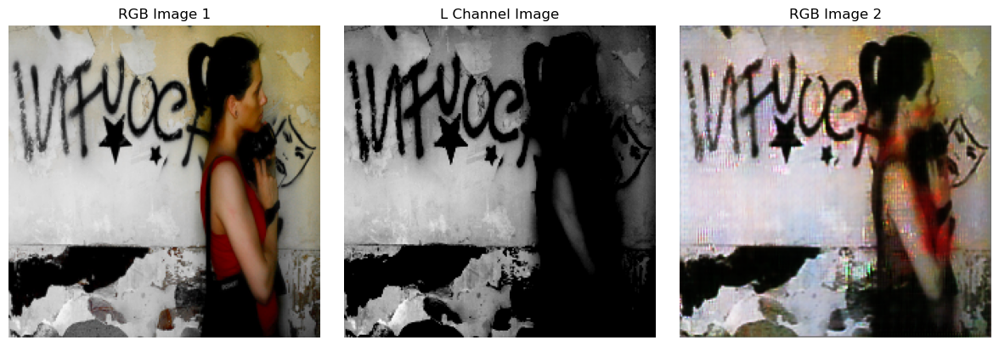

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [418/431], loss_g: 11.9816, loss_d: 1.3902, real_loss_d: 0.7868, fake_loss_d: 0.6034, fake_loss_g: 1.0378, distance_loss_g: 10.9438, duration: 217.5719


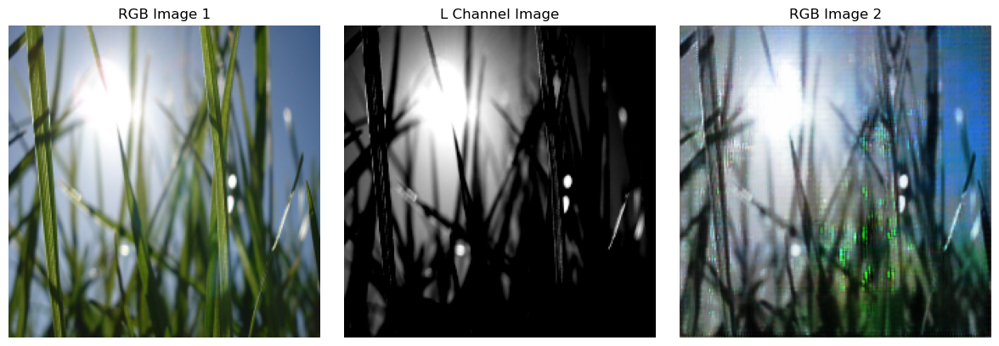

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [419/431], loss_g: 12.0628, loss_d: 1.2678, real_loss_d: 0.7242, fake_loss_d: 0.5436, fake_loss_g: 1.1188, distance_loss_g: 10.9440, duration: 229.1020


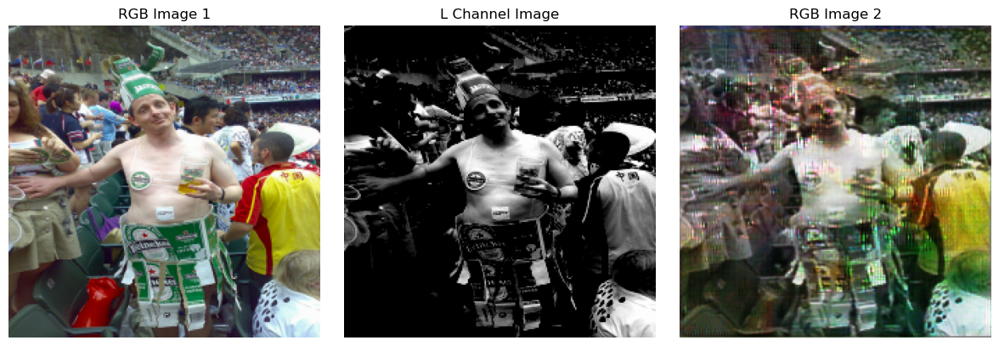

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [420/431], loss_g: 12.0590, loss_d: 1.2542, real_loss_d: 0.7324, fake_loss_d: 0.5218, fake_loss_g: 1.1731, distance_loss_g: 10.8859, duration: 240.5798


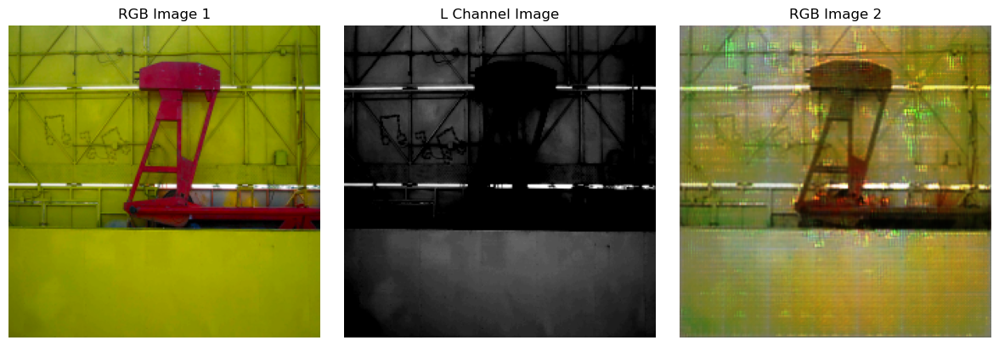

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [421/431], loss_g: 11.8546, loss_d: 1.3779, real_loss_d: 0.7442, fake_loss_d: 0.6337, fake_loss_g: 1.0578, distance_loss_g: 10.7968, duration: 251.8908


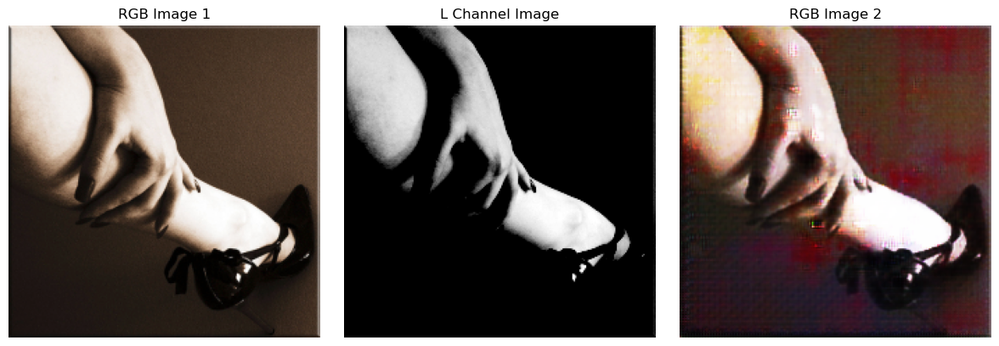

Model saved at epoch 421
Model saved at epoch 421


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [422/431], loss_g: 11.6115, loss_d: 1.6468, real_loss_d: 0.8405, fake_loss_d: 0.8063, fake_loss_g: 0.7866, distance_loss_g: 10.8249, duration: 263.1959


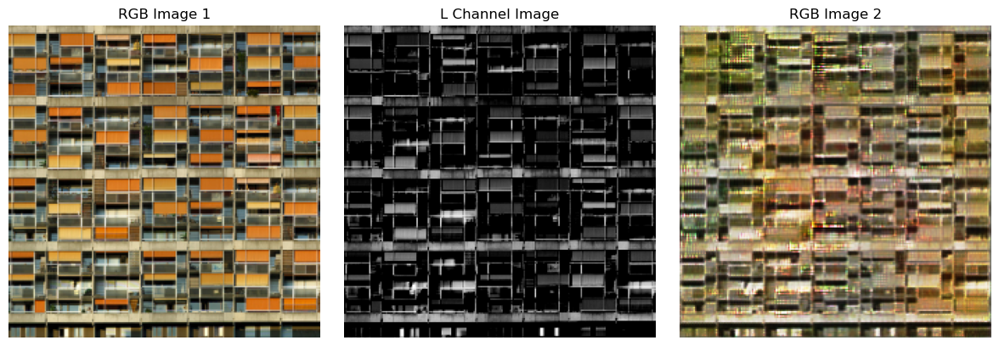

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [423/431], loss_g: 11.6895, loss_d: 1.7622, real_loss_d: 0.9415, fake_loss_d: 0.8207, fake_loss_g: 0.8006, distance_loss_g: 10.8889, duration: 274.4448


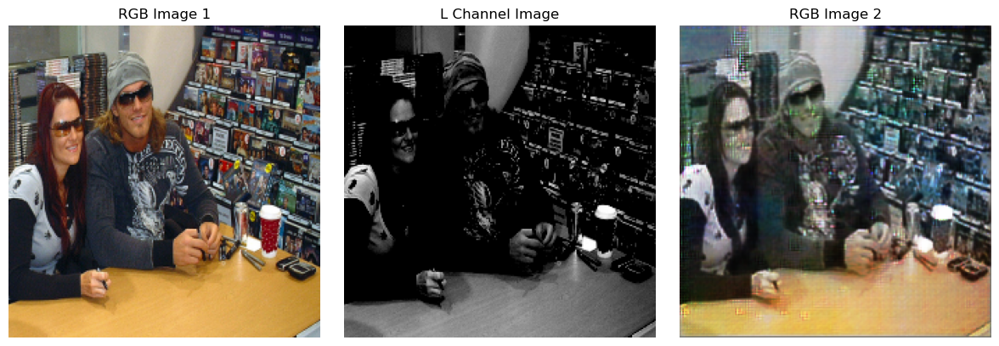

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [424/431], loss_g: 11.4700, loss_d: 1.8867, real_loss_d: 0.9807, fake_loss_d: 0.9060, fake_loss_g: 0.6595, distance_loss_g: 10.8105, duration: 285.5760


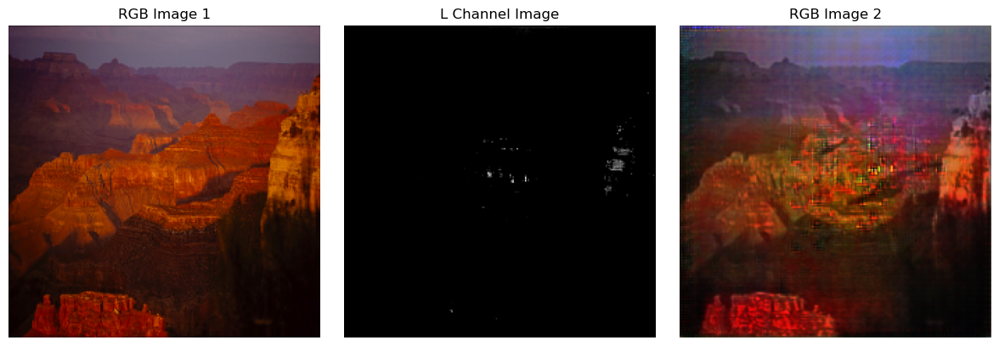

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [425/431], loss_g: 11.4586, loss_d: 1.9396, real_loss_d: 1.0148, fake_loss_d: 0.9248, fake_loss_g: 0.6714, distance_loss_g: 10.7872, duration: 296.8198


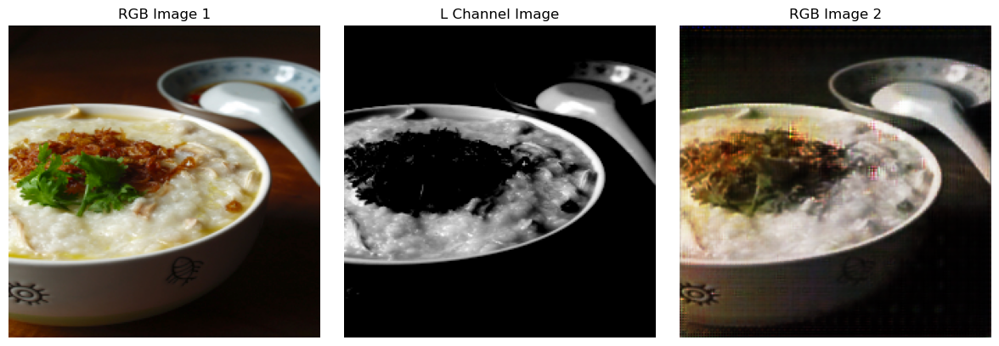

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [426/431], loss_g: 11.4612, loss_d: 2.0009, real_loss_d: 1.0680, fake_loss_d: 0.9329, fake_loss_g: 0.6441, distance_loss_g: 10.8171, duration: 308.5812


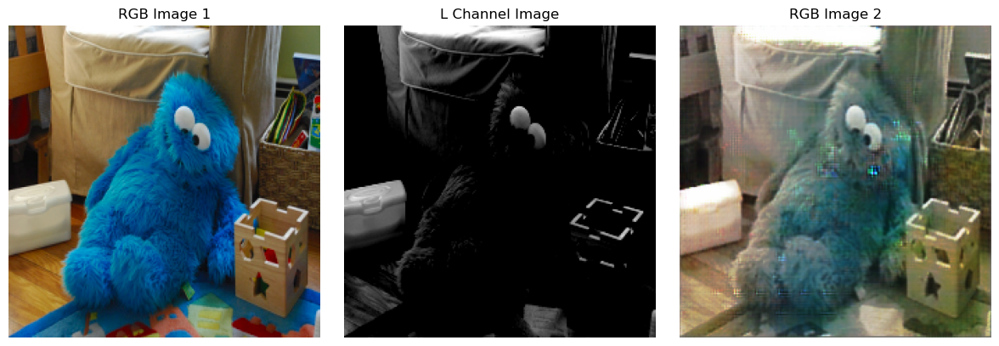

Model saved at epoch 426
Model saved at epoch 426


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [427/431], loss_g: 11.4224, loss_d: 1.9896, real_loss_d: 1.0951, fake_loss_d: 0.8945, fake_loss_g: 0.6617, distance_loss_g: 10.7607, duration: 320.6968


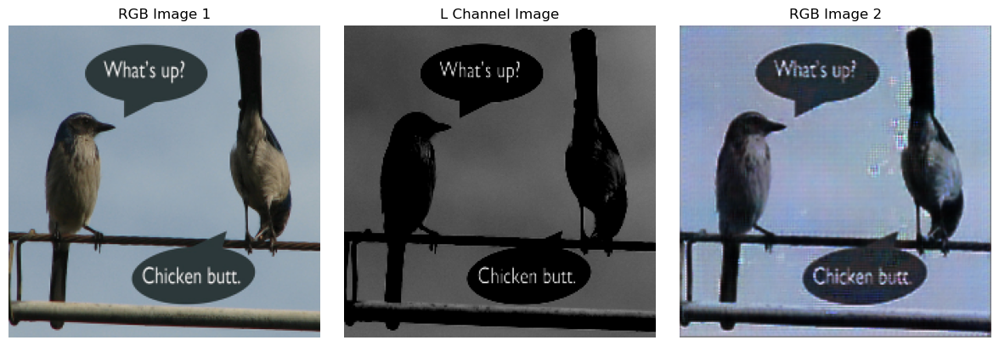

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [428/431], loss_g: 11.5388, loss_d: 1.9856, real_loss_d: 1.1052, fake_loss_d: 0.8804, fake_loss_g: 0.6815, distance_loss_g: 10.8574, duration: 331.8859


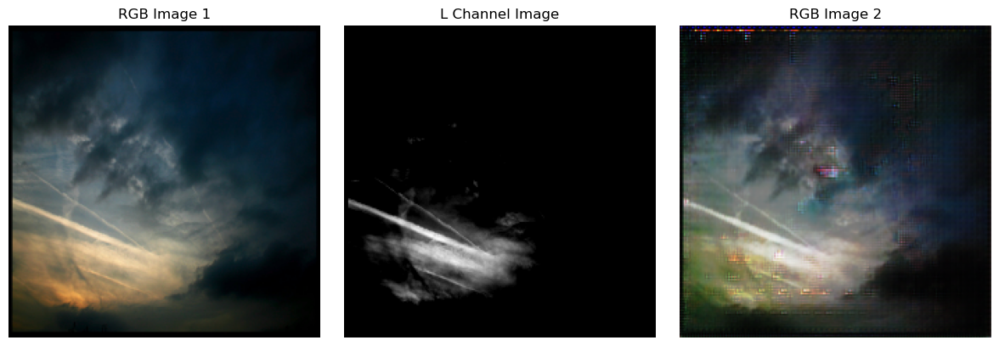

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [429/431], loss_g: 11.4786, loss_d: 2.1871, real_loss_d: 1.1249, fake_loss_d: 1.0622, fake_loss_g: 0.5286, distance_loss_g: 10.9500, duration: 343.0401


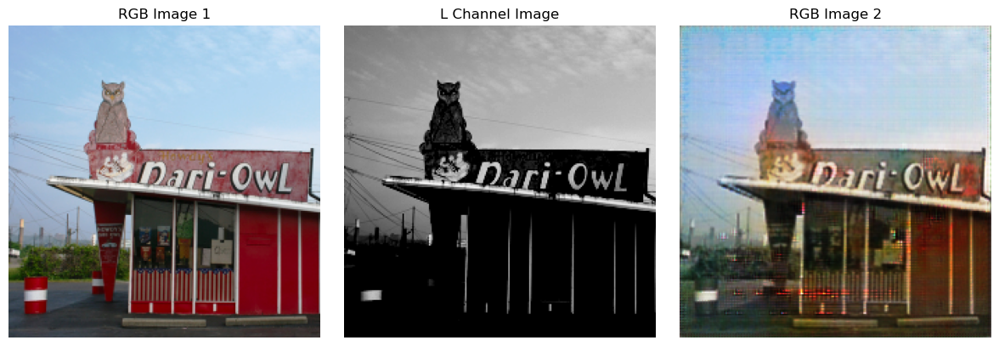

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [430/431], loss_g: 11.1959, loss_d: 2.4043, real_loss_d: 1.1550, fake_loss_d: 1.2494, fake_loss_g: 0.4206, distance_loss_g: 10.7754, duration: 354.1720


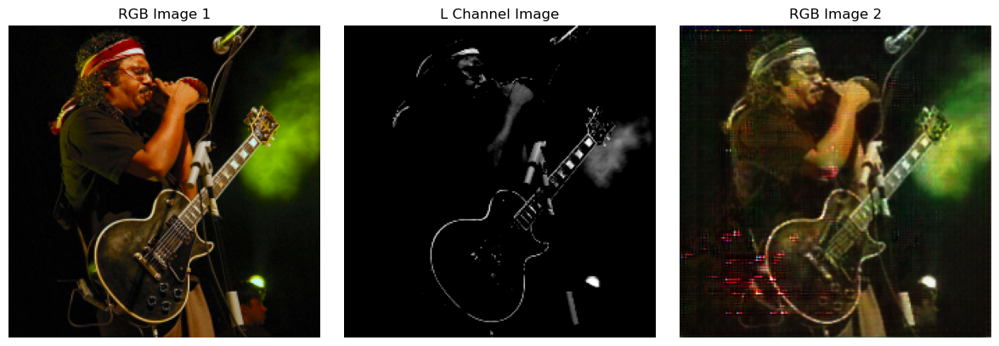

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch [431/431], loss_g: 10.9679, loss_d: 2.4571, real_loss_d: 1.1933, fake_loss_d: 1.2638, fake_loss_g: 0.4141, distance_loss_g: 10.5538, duration: 365.2807


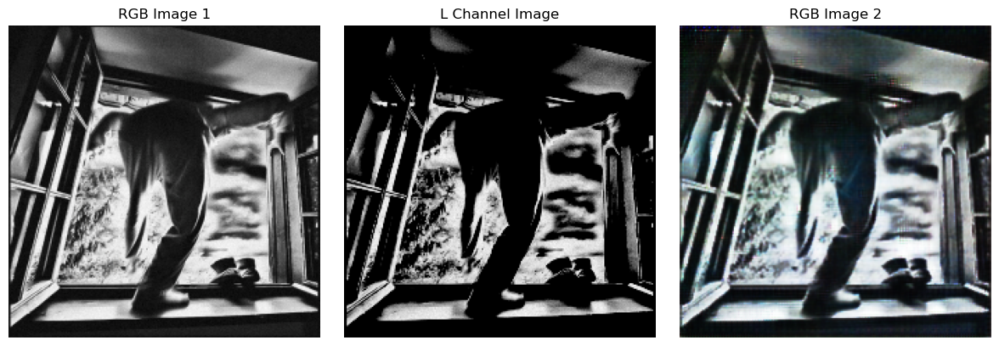

Model saved at epoch 431
Model saved at epoch 431


In [65]:
history = fit(431)

In [66]:
# Assuming 'Generator' is your model class, initialize the model
generator = Generator()  # Replace 'Generator' with the actual class name of your generator model

# Load the saved checkpoint
checkpoint = torch.load(r"gen\gen431ab3.pth")

# Load the generator model state dict from the checkpoint
generator.load_state_dict(checkpoint['model_state_dict'])

# Move the generator to the device (GPU or CPU)
generator = generator.to(device)

# Set the generator to evaluation mode
generator.eval()

print(f"Loaded Generator from Epoch: {checkpoint['epoch']}")
print(f"Last Generator Loss: {checkpoint['loss']}")


Loaded Generator from Epoch: 430
Last Generator Loss: 10.96792000570115


C:\Users\Vikash kumar singh\AppData\Local\Temp\ipykernel_16920\1079817122.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(r"gen\gen431ab3.pth")


In [67]:
import numpy as np
import matplotlib.pyplot as plt

def show_image(bw_image_tensor, rgb_image_tensor, normalization='[-1,1]'):
    # Move tensors to CPU if on CUDA
    if bw_image_tensor.is_cuda:
        bw_image_tensor = bw_image_tensor.cpu()
    if rgb_image_tensor.is_cuda:
        rgb_image_tensor = rgb_image_tensor.cpu()

    # Convert tensors to NumPy arrays
    bw_image_np = bw_image_tensor.detach().numpy()
    rgb_image_np = rgb_image_tensor.detach().numpy()

    # Denormalize the black-and-white image
    if normalization == '[-1,1]':
        bw_image_np = (bw_image_np + 1) / 2 * 255  # Denormalizing from [-1, 1] to [0, 255]
    elif normalization == '[0,1]':
        bw_image_np = bw_image_np * 255  # Denormalizing from [0, 1] to [0, 255]

    bw_image_np = bw_image_np.astype(np.uint8).squeeze()  # Remove channel dimension if present

    # Denormalize the RGB image
    if normalization == '[-1,1]':
        rgb_image_np = (rgb_image_np + 1) / 2 * 255  # Denormalizing from [-1, 1] to [0, 255]
    elif normalization == '[0,1]':
        rgb_image_np = rgb_image_np * 255  # Denormalizing from [0, 1] to [0, 255]

    rgb_image_np = rgb_image_np.astype(np.uint8)

    # Prepare the figures for displaying images
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Display the black-and-white image
    axes[0].imshow(bw_image_np, cmap='gray')
    axes[0].axis('off')
    axes[0].set_title('Black and White Image')

    # Display the generated RGB image
    axes[1].imshow(rgb_image_np.transpose(1, 2, 0))  # Transpose for correct shape (H, W, C)
    axes[1].axis('off')
    axes[1].set_title('Generated RGB Image')

    plt.show()

# Example usage
# show_image(bw_image_tensor, rgb_image_tensor, normalization='[-1,1]')


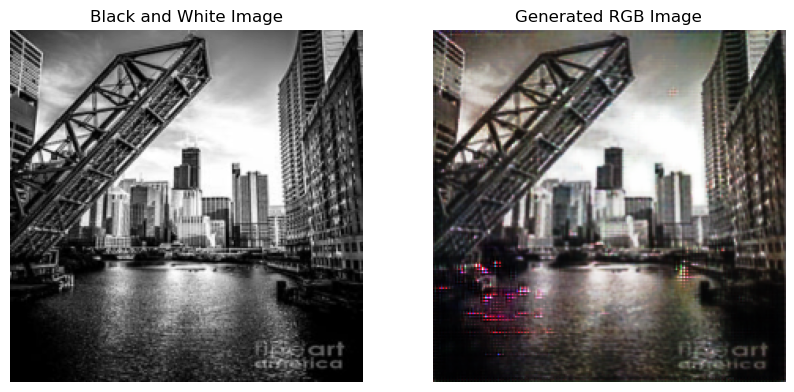

In [70]:
from PIL import Image
import torchvision.transforms as transforms

path = r"chicago-kinzie-street-bridge-black-and-white-picture-paul-velgos.jpg"
image = Image.open(path).convert('L')  # Convert to grayscale (L-channel)

# Preprocess the image (e.g., resize, convert to tensor, normalize)
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Assuming the input size expected by the generator is 256x256
    transforms.ToTensor(),          # Convert to tensor and normalize to [0, 1]
    transforms.Normalize(mean=[0.5], std=[0.5])  # Normalize to range [-1, 1] (if needed)
])

l_image = transform(image).unsqueeze(0).to(device)  # Add batch dimension and move to GPU/CPU

# Pass through the generator
with torch.no_grad():
    colorized_output = generator(l_image)

# Remove batch dimension for visualization
colorized_image = colorized_output.squeeze(0)

# Show the generated image
show_image(l_image,colorized_image)

In [64]:
losses_g, losses_d, real_losses_d, fake_losses_d, fake_losses_g, distance_losses_g = history

Text(0.5, 1.0, 'Losses')

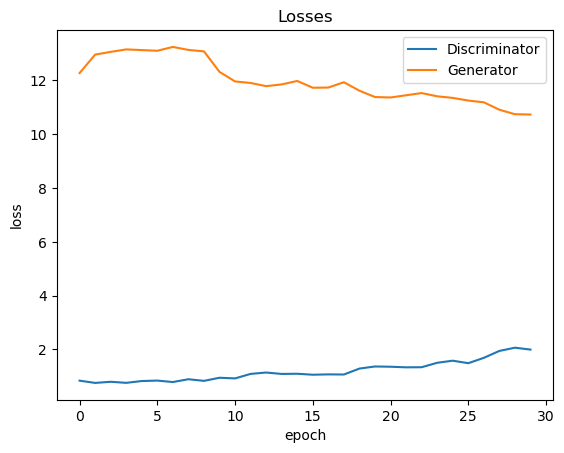

In [65]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses')

Text(0.5, 1.0, 'd_losses')

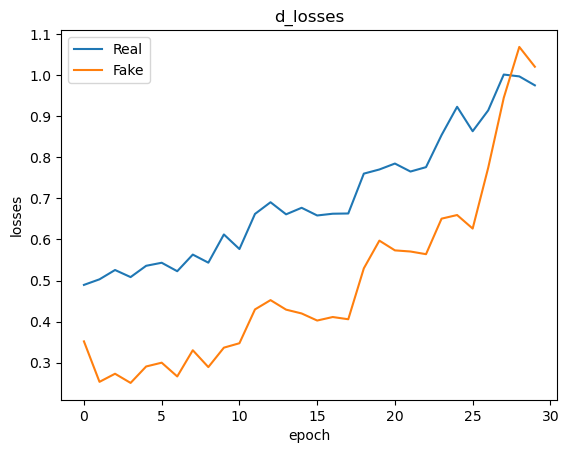

In [66]:
real_losses_d = np.array([loss.cpu().detach().numpy() for loss in real_losses_d])
fake_losses_d = np.array([loss.cpu().detach().numpy() for loss in fake_losses_d])

plt.plot(real_losses_d, '-')
plt.plot(fake_losses_d, '-')
plt.xlabel('epoch')
plt.ylabel('losses')
plt.legend(['Real', 'Fake'])
plt.title('d_losses')

Text(0.5, 1.0, 'g_losses')

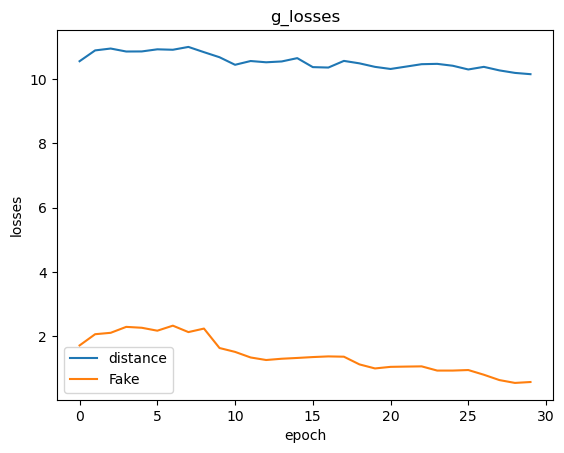

In [67]:
distance_losses_g = np.array([loss.cpu().detach().numpy() for loss in distance_losses_g])
fake_losses_g = np.array([loss.cpu().detach().numpy() for loss in fake_losses_g])

plt.plot(distance_losses_g, '-')
plt.plot(fake_losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('losses')
plt.legend(['distance', 'Fake'])
plt.title('g_losses')